# 秦潤川

In [ ]:
import numpy as np
from pandas import DataFrame
from pandas import Series
import pandas as pd
from google.colab import drive

In [ ]:
pd.set_option('display.float_format', '{:.2f}'.format)
drive.mount('/content/drive')
XGB_df = pd.read_csv('/content/drive/My Drive/ML Project/BOND_Data/XGB_1211.csv')
XGB_df['trd_exctn_dt'] = pd.to_datetime(XGB_df['trd_exctn_dt'])
XGB_df['year'] = pd.to_datetime(XGB_df['trd_exctn_dt']).dt.year


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# EDA

## Full Sample Description

In [ ]:
from scipy import stats
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.dates import YearLocator, DateFormatter
import random
import seaborn as sns

Descriptive statistics of main variables and subsample by default type

In [ ]:
XGB_df['trd_exctn_dt'] = pd.to_datetime(XGB_df['trd_exctn_dt'])
XGB_df['year'] = pd.to_datetime(XGB_df['trd_exctn_dt']).dt.year

ND_df = XGB_df[XGB_df['default'] == 0]
DF_df = XGB_df[XGB_df['default'] == 1]


In [ ]:
ND_df['life_period'] = ND_df.groupby('cusip_id')['trd_exctn_dt'].transform(lambda x: x.max() - x.min())
DF_df['life_period'] = DF_df.groupby('cusip_id')['trd_exctn_dt'].transform(lambda x: x.max() - x.min())

ND_df = ND_df[ND_df['life_period'] >= pd.Timedelta(days=360)]
DF_df = DF_df[DF_df['life_period'] >= pd.Timedelta(days=360)]


<ipython-input-4-1e08ec374fca>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ND_df['life_period'] = ND_df.groupby('cusip_id')['trd_exctn_dt'].transform(lambda x: x.max() - x.min())
<ipython-input-4-1e08ec374fca>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DF_df['life_period'] = DF_df.groupby('cusip_id')['trd_exctn_dt'].transform(lambda x: x.max() - x.min())


In [ ]:
unique_cusip_df = DF_df['cusip_id'].nunique()
unique_cusip_nd = ND_df['cusip_id'].nunique()

print("number of default bond :", unique_cusip_df)
print("number of non-default bond :", unique_cusip_nd)

number of default bond : 42
number of non-default bond : 141


In [ ]:
np.round(XGB_df.describe(), 2).T

,count,mean,std,min,25%,50%,75%,max
rptd_pr,1879996.00,95.37,23.41,0.00,85.50,100.56,108.65,5916.71
entrd_vol_qt,1879996.00,200314.25,18782835.39,0.00,20.00,2000.00,20000.00,8813000000.00
yld_pt,1879996.00,21.48,1131.41,0.00,3.53,7.20,11.04,431314.48
rpt_side_cd,1879996.00,0.55,0.50,0.00,0.00,1.00,1.00,1.00
trdg_mkt_cd,1879996.00,1.00,0.02,0.00,1.00,1.00,1.00,1.00
days_to_default,949436.00,1220.83,880.26,1.00,479.00,1100.00,1771.00,3870.00
age,1879996.00,3346.00,2942.07,0.00,1177.00,2219.00,5250.00,23085.00
trd_freq,1879996.00,65.09,181.24,1.00,11.00,24.00,53.00,2805.00
time_interval_minutes,1879996.00,460.35,10962.07,0.00,0.00,0.10,14.53,4514339.85
default,1879996.00,0.51,0.50,0.00,0.00,1.00,1.00,1.00


In [ ]:
np.round(DF_df.describe(), 2).T

,count,mean,std,min,25%,50%,75%,max
rptd_pr,939201.00,81.36,20.64,0.00,71.70,86.20,95.74,697.75
entrd_vol_qt,939201.00,477.43,20788.07,0.00,10.00,20.00,100.00,9196000.00
yld_pt,939201.00,37.58,1600.51,0.02,8.44,10.78,16.87,431314.48
rpt_side_cd,939201.00,0.55,0.50,0.00,0.00,1.00,1.00,1.00
trdg_mkt_cd,939201.00,1.00,0.02,0.00,1.00,1.00,1.00,1.00
days_to_default,939201.00,1232.33,878.06,1.00,496.00,1117.00,1778.00,3870.00
age,939201.00,2839.25,2479.87,0.00,934.00,1944.00,4808.00,10379.00
trd_freq,939201.00,95.58,243.85,1.00,18.00,36.00,76.00,2805.00
time_interval_minutes,939201.00,165.62,5054.99,0.00,0.00,0.10,8.42,1949615.13
default,939201.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00


In [ ]:
np.round(ND_df.describe(), 2).T

,count,mean,std,min,25%,50%,75%,max
rptd_pr,930212.00,110.30,14.02,10.00,102.66,108.20,115.44,5916.71
entrd_vol_qt,930212.00,404238.00,26700724.46,0.01,10000.00,20000.00,60000.00,8813000000.00
yld_pt,930212.00,4.12,3.39,0.00,2.66,3.51,4.90,1240.07
rpt_side_cd,930212.00,0.55,0.50,0.00,0.00,1.00,1.00,1.00
trdg_mkt_cd,930212.00,1.00,0.01,0.00,1.00,1.00,1.00,1.00
days_to_default,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
age,930212.00,3878.79,3270.55,25.00,1410.00,2682.00,6711.00,23085.00
trd_freq,930212.00,33.81,65.48,1.00,7.00,15.00,32.00,917.00
time_interval_minutes,930212.00,761.12,14717.06,0.00,0.00,0.08,27.82,4514339.85
default,930212.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


life period polt

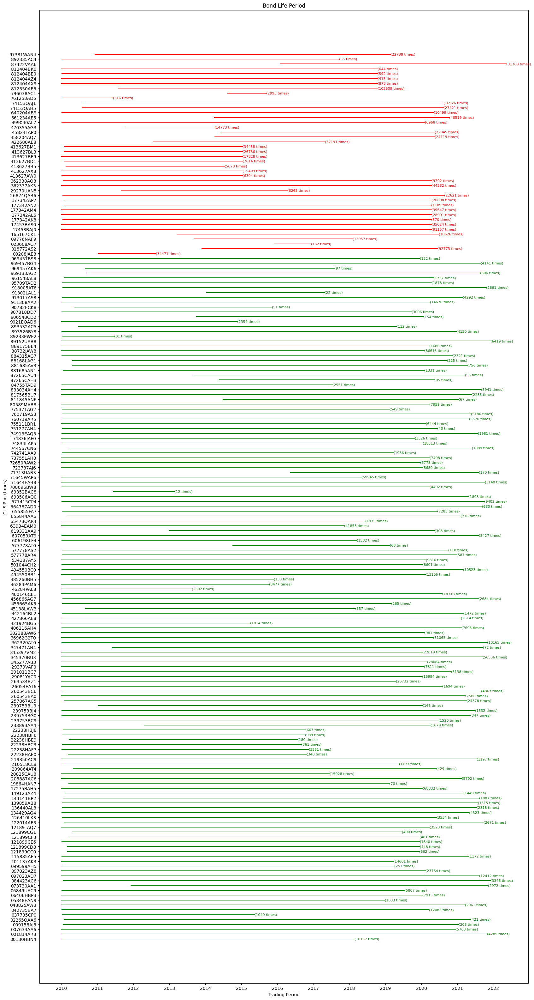

In [ ]:
# Calculate the life period for each CUSIP in ND_df and DF_df
ND_df['life_period'] = ND_df.groupby('cusip_id')['trd_exctn_dt'].transform(lambda x: x.max() - x.min())
DF_df['life_period'] = DF_df.groupby('cusip_id')['trd_exctn_dt'].transform(lambda x: x.max() - x.min())

# Filter out CUSIPs with a life period greater than or equal to one year
nd_cusip_to_keep = ND_df[ND_df['life_period'] >= pd.Timedelta(days=360)]['cusip_id'].unique()
df_cusip_to_keep = DF_df[DF_df['life_period'] >= pd.Timedelta(days=360)]['cusip_id'].unique()

# Filter the dataframes based on the selected CUSIPs
ND_df = ND_df[ND_df['cusip_id'].isin(nd_cusip_to_keep)]
DF_df = DF_df[DF_df['cusip_id'].isin(df_cusip_to_keep)]

# Create the timeline plot
plt.figure(figsize=(20, 40))
for cusip_df, color in [(ND_df, 'green'), (DF_df, 'red')]:
    for cusip in cusip_df['cusip_id'].unique():
        cusip_data = cusip_df[cusip_df['cusip_id'] == cusip]
        earliest_date = cusip_data['trd_exctn_dt'].min()
        latest_date = cusip_data['trd_exctn_dt'].max()
        plt.plot([earliest_date, latest_date], [cusip, cusip], color=color)
        plt.text(latest_date, cusip, f'({cusip_data.shape[0]} times)',
                 fontsize=8, verticalalignment='center', color=color)

plt.xlabel('Trading Period')
plt.ylabel('CUSIP id (times)')
plt.title('Bond Life Period')

# Set the x-axis ticks
ax = plt.gca()
years = YearLocator()
ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(DateFormatter("%Y"))

plt.show()


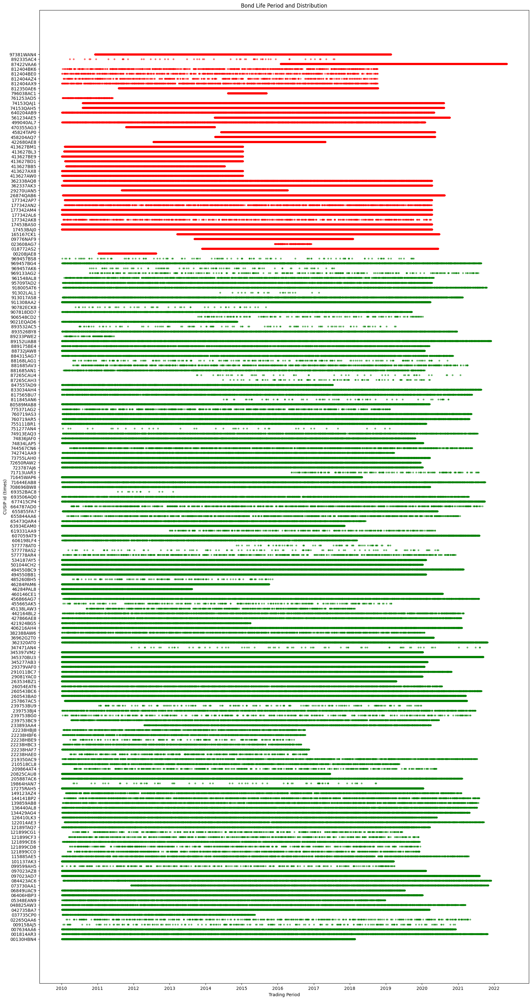

In [ ]:
plt.figure(figsize=(20, 40))  # Adjust the figure size
for cusip in ND_df['cusip_id'].unique():
    nd_cusip_data = ND_df[ND_df['cusip_id'] == cusip]
    earliest_date = nd_cusip_data['trd_exctn_dt'].min()
    latest_date = nd_cusip_data['trd_exctn_dt'].max()

    # Plot a random scatter of points for each CUSIP
    x_points = [random.uniform(earliest_date, latest_date) for _ in range(nd_cusip_data.shape[0])]
    y_points = [cusip] * len(x_points)
    plt.scatter(x_points, y_points, marker='.', color='green', alpha=0.5)

for cusip in DF_df['cusip_id'].unique():
    df_cusip_data = DF_df[DF_df['cusip_id'] == cusip]
    earliest_date = df_cusip_data['trd_exctn_dt'].min()
    latest_date = df_cusip_data['trd_exctn_dt'].max()

    # Plot a random scatter of points for each CUSIP
    x_points = [random.uniform(earliest_date, latest_date) for _ in range(df_cusip_data.shape[0])]
    y_points = [cusip] * len(x_points)
    plt.scatter(x_points, y_points, marker='.', color='red', alpha=0.5)

plt.xlabel('Trading Period')
plt.ylabel('CUSIP id (times)')
plt.title('Bond Life Period and Distribution')

# Set the x-axis ticks
ax = plt.gca()
years = YearLocator()  # Major ticks for each year
ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(DateFormatter("%Y"))  # Format as years

# Display the plot
plt.show()


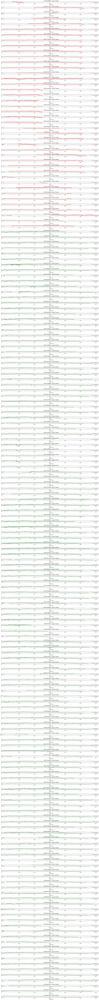

In [ ]:
# Combine DF_df and ND_df into a single dataframe with a 'source' column to distinguish between them
DF_df['source'] = 'DF'
ND_df['source'] = 'ND'
combined_df = pd.concat([DF_df, ND_df])

# Convert the 'trd_exctn_dt' column to date format
combined_df['trd_exctn_dt'] = pd.to_datetime(combined_df['trd_exctn_dt'])

# Get the unique CUSIPs
cusips = combined_df['cusip_id'].unique()

# Determine the overall time range for all CUSIPs
min_date = combined_df['trd_exctn_dt'].min()
max_date = combined_df['trd_exctn_dt'].max()

# Create a long, vertical plot for each CUSIP's rptd_pr changes
plt.figure(figsize=(20, 200))  # Adjust the figure size (width and height)

for i, cusip in enumerate(cusips):
    cusip_data = combined_df[combined_df['cusip_id'] == cusip]

    plt.subplot(len(cusips), 1, i + 1)  # Create a subplot for each CUSIP
    plt.plot(cusip_data['trd_exctn_dt'], cusip_data['rptd_pr'], color='red' if cusip_data['source'].iloc[0] == 'DF' else 'green', label=f'{cusip_data["source"].iloc[0]} {cusip}')

    plt.xlabel('Trading Date')
    plt.ylabel('rptd_pr')
    plt.title(f'CUSIP {cusip} - rptd_pr Changes')

    # Set the x-axis range to be the same for all subplots
    plt.xlim(min_date, max_date)

    # Set the y-axis range to a percentage of the data range
    y_range_percentage = 10  # Adjust this value as needed
    y_min = cusip_data['rptd_pr'].min() - (cusip_data['rptd_pr'].max() - cusip_data['rptd_pr'].min()) * y_range_percentage / 100
    y_max = cusip_data['rptd_pr'].max() + (cusip_data['rptd_pr'].max() - cusip_data['rptd_pr'].min()) * y_range_percentage / 100
    plt.ylim(y_min, y_max)

    plt.legend()
    plt.grid(True)

plt.tight_layout()  # Ensure proper spacing between subplots
plt.show()


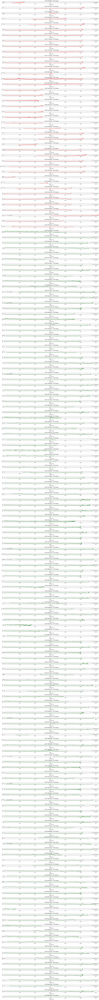

In [ ]:
# Determine the overall time range for all CUSIPs
min_date = combined_df['trd_exctn_dt'].min()
max_date = combined_df['trd_exctn_dt'].max()

# Create a long, vertical plot for each CUSIP's rptd_pr changes
plt.figure(figsize=(20, 200))  # Adjust the figure size (width and height)

for i, cusip in enumerate(cusips):
    cusip_data = combined_df[combined_df['cusip_id'] == cusip]

    plt.subplot(len(cusips), 1, i + 1)  # Create a subplot for each CUSIP
    plt.plot(cusip_data['trd_exctn_dt'], cusip_data['yld_pt'], color='red' if cusip_data['source'].iloc[0] == 'DF' else 'green', label=f'{cusip_data["source"].iloc[0]} {cusip}')

    plt.xlabel('Trading Date')
    plt.ylabel('yld_pt')
    plt.title(f'CUSIP {cusip} - YTM Changes')

    # Set the x-axis range to be the same for all subplots
    plt.xlim(min_date, max_date)

    # Set the y-axis range to a percentage of the data range
    y_range_percentage = 10  # Adjust this value as needed
    y_min = cusip_data['yld_pt'].min() - (cusip_data['yld_pt'].max() - cusip_data['yld_pt'].min()) * y_range_percentage / 100
    y_max = cusip_data['yld_pt'].max() + (cusip_data['yld_pt'].max() - cusip_data['yld_pt'].min()) * y_range_percentage / 100
    plt.ylim(y_min, y_max)

    plt.legend()
    plt.grid(True)

plt.tight_layout()  # Ensure proper spacing between subplots
plt.show()

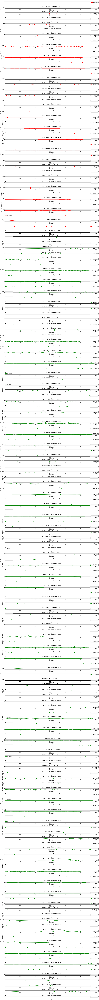

In [ ]:
# Determine the overall time range for all CUSIPs
min_date = combined_df['trd_exctn_dt'].min()
max_date = combined_df['trd_exctn_dt'].max()

# Create a long, vertical plot for each CUSIP's rptd_pr changes
plt.figure(figsize=(20, 200))  # Adjust the figure size (width and height)

for i, cusip in enumerate(cusips):
    cusip_data = combined_df[combined_df['cusip_id'] == cusip]

    plt.subplot(len(cusips), 1, i + 1)  # Create a subplot for each CUSIP
    plt.plot(cusip_data['trd_exctn_dt'], cusip_data['entrd_vol_qt'], color='red' if cusip_data['source'].iloc[0] == 'DF' else 'green', label=f'{cusip_data["source"].iloc[0]} {cusip}')

    plt.xlabel('Trading Date')
    plt.ylabel('Size of Deal')
    plt.title(f'CUSIP {cusip} - Trading Volume Changes')

    # Set the x-axis range to be the same for all subplots
    plt.xlim(min_date, max_date)

    # Set the y-axis range to a percentage of the data range
    y_range_percentage = 10  # Adjust this value as needed
    y_min = cusip_data['entrd_vol_qt'].min() - (cusip_data['entrd_vol_qt'].max() - cusip_data['entrd_vol_qt'].min()) * y_range_percentage / 100
    y_max = cusip_data['entrd_vol_qt'].max() + (cusip_data['entrd_vol_qt'].max() - cusip_data['entrd_vol_qt'].min()) * y_range_percentage / 100
    plt.ylim(y_min, y_max)

    plt.legend()
    plt.grid(True)

plt.tight_layout()  # Ensure proper spacing between subplots
plt.show()

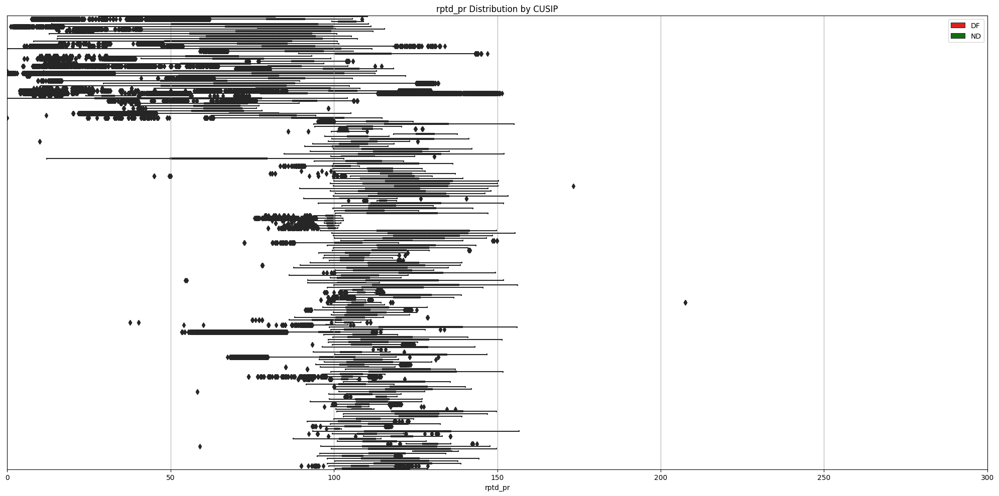

In [ ]:
# Combine DF_df and ND_df into a single dataframe with a 'source' column to distinguish between them
DF_df['source'] = 'DF'
ND_df['source'] = 'ND'
combined_df = pd.concat([DF_df, ND_df])

# Get the unique CUSIPs
cusips = combined_df['cusip_id'].unique()

# Create a long, vertical plot for rptd_pr using box plots
plt.figure(figsize=(20, 10))  # Adjust the figure size (width and height)

data_to_plot = []

for cusip in cusips:
    cusip_data = combined_df[combined_df['cusip_id'] == cusip]
    data_to_plot.append(cusip_data)

# Create a box plot for rptd_pr for each CUSIP, using red for DF and green for ND
ax = sns.boxplot(x='rptd_pr', y='cusip_id', hue='source', data=pd.concat(data_to_plot), palette={"DF": "red", "ND": "green"})

plt.xlabel('rptd_pr')
plt.title('rptd_pr Distribution by CUSIP')

ax.legend(title='')
ax.set_ylabel('')

# Set x-axis range from 0 to 300
ax.set_xlim(0, 300)

# Remove y-axis ticks and labels
ax.set_yticks([])
ax.set_yticklabels([])

plt.grid(True)

plt.tight_layout()  # Ensure proper spacing between subplots
plt.show()


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


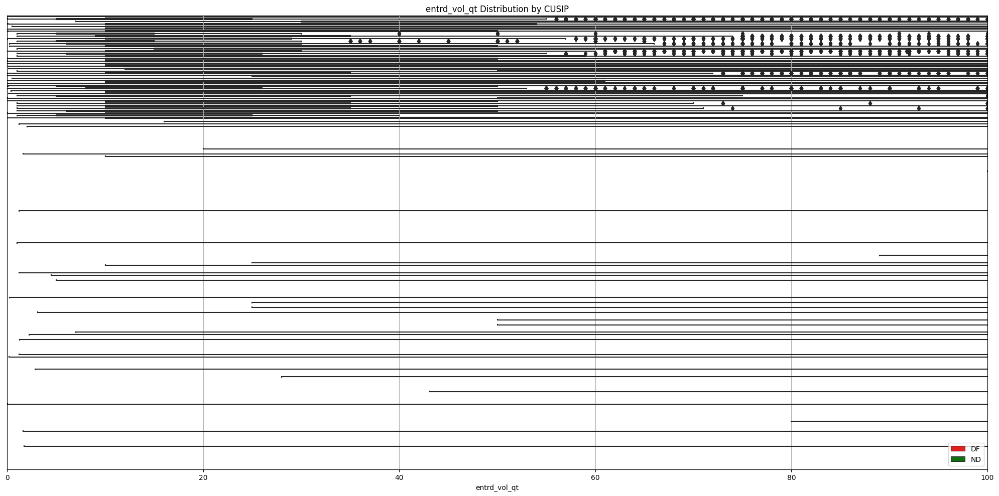

In [ ]:
# Combine DF_df and ND_df into a single dataframe with a 'source' column to distinguish between them
DF_df['source'] = 'DF'
ND_df['source'] = 'ND'
combined_df = pd.concat([DF_df, ND_df])

# Get the unique CUSIPs
cusips = combined_df['cusip_id'].unique()

# Create a long, vertical plot for rptd_pr using box plots
plt.figure(figsize=(20, 10))  # Adjust the figure size (width and height)

data_to_plot = []

for cusip in cusips:
    cusip_data = combined_df[combined_df['cusip_id'] == cusip]
    data_to_plot.append(cusip_data)

# Create a box plot for rptd_pr for each CUSIP, using red for DF and green for ND
ax = sns.boxplot(x='entrd_vol_qt', y='cusip_id', hue='source', data=pd.concat(data_to_plot), palette={"DF": "red", "ND": "green"})

plt.xlabel('entrd_vol_qt')
plt.title('entrd_vol_qt Distribution by CUSIP')

ax.legend(title='')
ax.set_ylabel('')

# Set x-axis range from 0 to 300
ax.set_xlim(0, 100)

# Remove y-axis ticks and labels
ax.set_yticks([])
ax.set_yticklabels([])

plt.grid(True)

plt.tight_layout()  # Ensure proper spacing between subplots
plt.show()


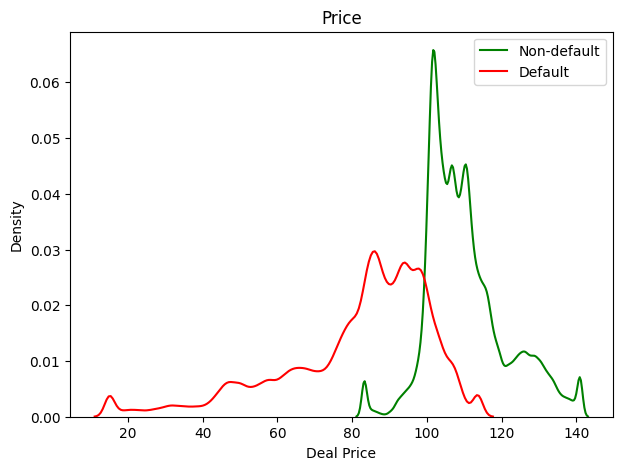

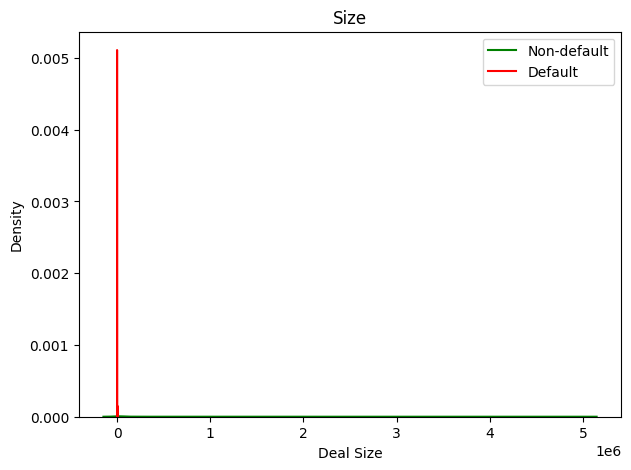

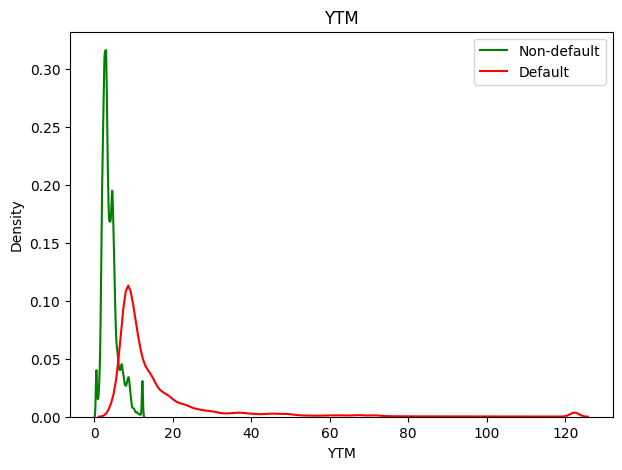

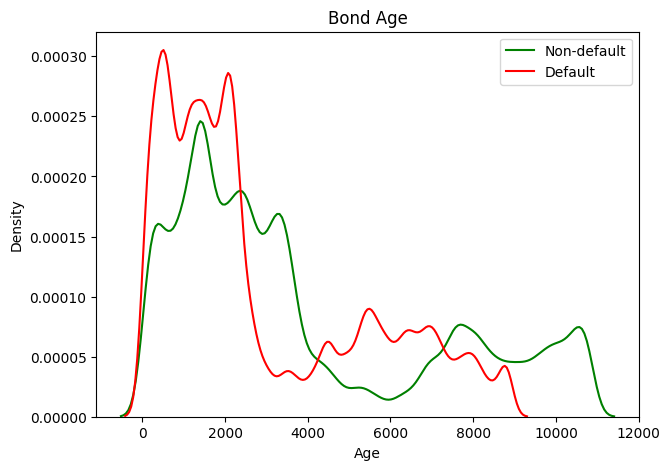

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

def winsorize(series):
    lower_bound = series.quantile(0.01)
    upper_bound = series.quantile(0.99)
    return series.apply(lambda x: min(upper_bound, max(lower_bound, x)))

cols_to_winsorize = ['rptd_pr', 'entrd_vol_qt', 'yld_pt', 'age']
for col in cols_to_winsorize:
    DF_df[col] = winsorize(DF_df[col])
    ND_df[col] = winsorize(ND_df[col])

plt.figure(figsize=(7, 5))
sns.kdeplot(data=ND_df, x='rptd_pr', color='green', label='Non-default')
sns.kdeplot(data=DF_df, x='rptd_pr', color='red', label='Default')
plt.xlabel('Deal Price')
plt.legend()
plt.title('Price')
plt.show()

plt.figure(figsize=(7, 5))
sns.kdeplot(data=ND_df, x='entrd_vol_qt', color='green', label='Non-default')
sns.kdeplot(data=DF_df, x='entrd_vol_qt', color='red', label='Default')
plt.xlabel('Deal Size')
plt.legend()
plt.title('Size')
plt.show()

plt.figure(figsize=(7, 5))
sns.kdeplot(data=ND_df, x='yld_pt', color='green', label='Non-default')
sns.kdeplot(data=DF_df, x='yld_pt', color='red', label='Default')
plt.xlabel('YTM')
plt.legend()
plt.title('YTM')
plt.show()

plt.figure(figsize=(7, 5))
sns.kdeplot(data=ND_df, x='age', color='green', label='Non-default')
sns.kdeplot(data=DF_df, x='age', color='red', label='Default')
plt.xlabel('Age')
plt.legend()
plt.title('Bond Age')

plt.show()


## 1. Pairwise Scatter Plot

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

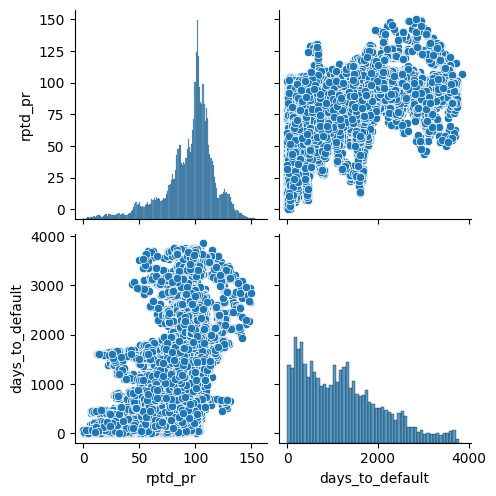

In [ ]:
numeric_vars1 = ['rptd_pr', 'days_to_default']

vol_filter0 = XGB_df[numeric_vars1].sample(frac=0.05)

sns.pairplot(vol_filter0[numeric_vars1])  # Use a sample for efficiency

plt.show()

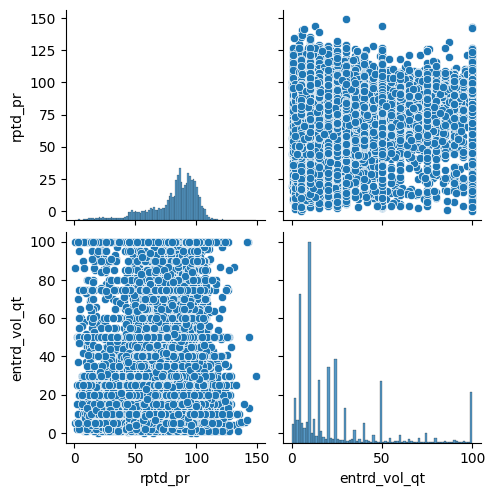

In [ ]:
numeric_vars2 = ['rptd_pr', 'entrd_vol_qt']

vol_filter = XGB_df[numeric_vars2].query('0 <= entrd_vol_qt <= 100').sample(frac=0.05)

sns.pairplot(vol_filter[numeric_vars2])

plt.show()



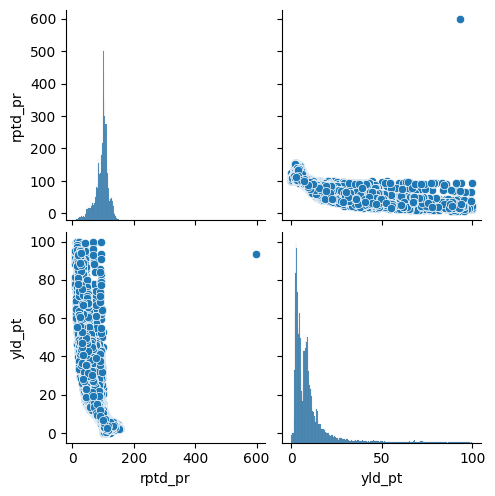

In [ ]:
numeric_vars3 = ['rptd_pr', 'yld_pt']

yld_sample = XGB_df[numeric_vars3].query('0 <= yld_pt <= 100').sample(frac=0.05)

sns.pairplot(yld_sample)

plt.show()

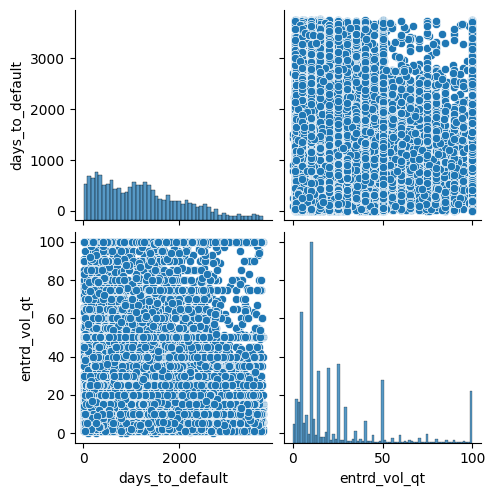

In [ ]:
numeric_vars4 = ['days_to_default','entrd_vol_qt']

vol_filter4 = XGB_df[numeric_vars4].query('0 <= entrd_vol_qt <= 100').sample(frac=0.05)
sns.pairplot(vol_filter4[numeric_vars4])  # Use a sample for efficiency
plt.show()

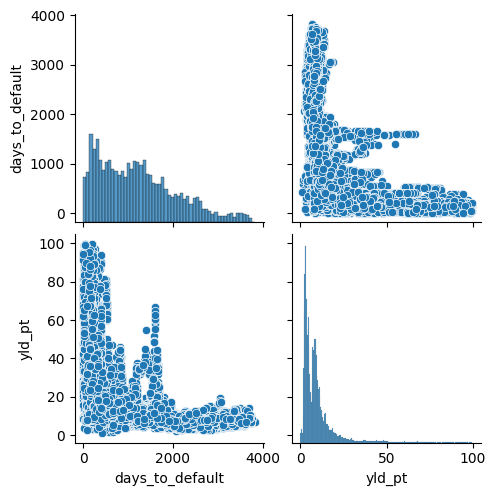

In [ ]:
numeric_vars5 = ['days_to_default','yld_pt']

yld_sample2 = XGB_df[numeric_vars5].query('0 <= yld_pt <= 100').sample(frac=0.05)

sns.pairplot(yld_sample2)

plt.show()

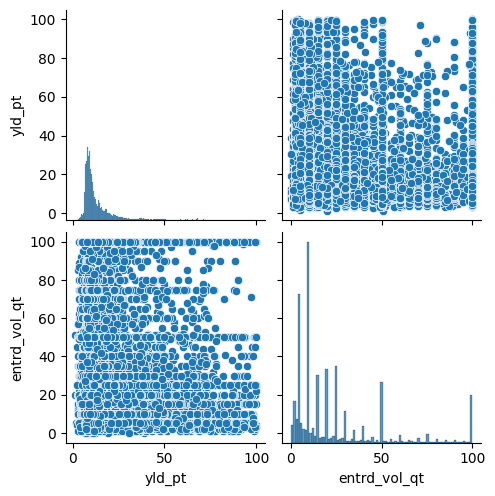

In [ ]:
numeric_vars6 = ['yld_pt','entrd_vol_qt']

vol_filter6 = XGB_df[numeric_vars6].query('0 <= yld_pt <= 100 & 0 <= entrd_vol_qt <= 100').sample(frac=0.05)
sns.pairplot(vol_filter6[numeric_vars6])
plt.show()

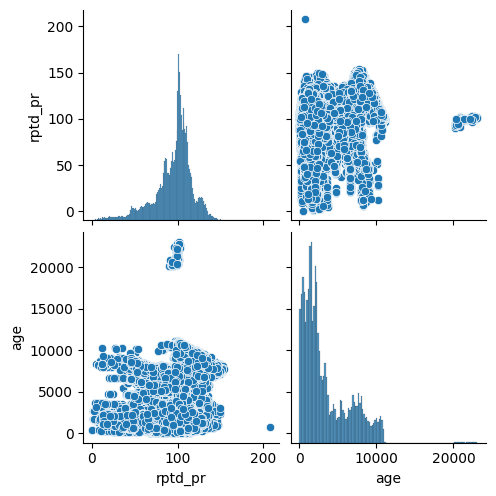

In [ ]:
numeric_vars7 = ['rptd_pr', 'age']

vol_filter7 = XGB_df[numeric_vars7].sample(frac=0.05)

sns.pairplot(vol_filter7[numeric_vars7])  # Use a sample for efficiency

plt.show()

In [ ]:
numeric_vars8 = ['yld_pt', 'age']

vol_filter8 = XGB_df[numeric_vars8].sample(frac=0.05)

sns.pairplot(vol_filter8[numeric_vars8])  # Use a sample for efficiency

plt.show()

## 2. Heatmap

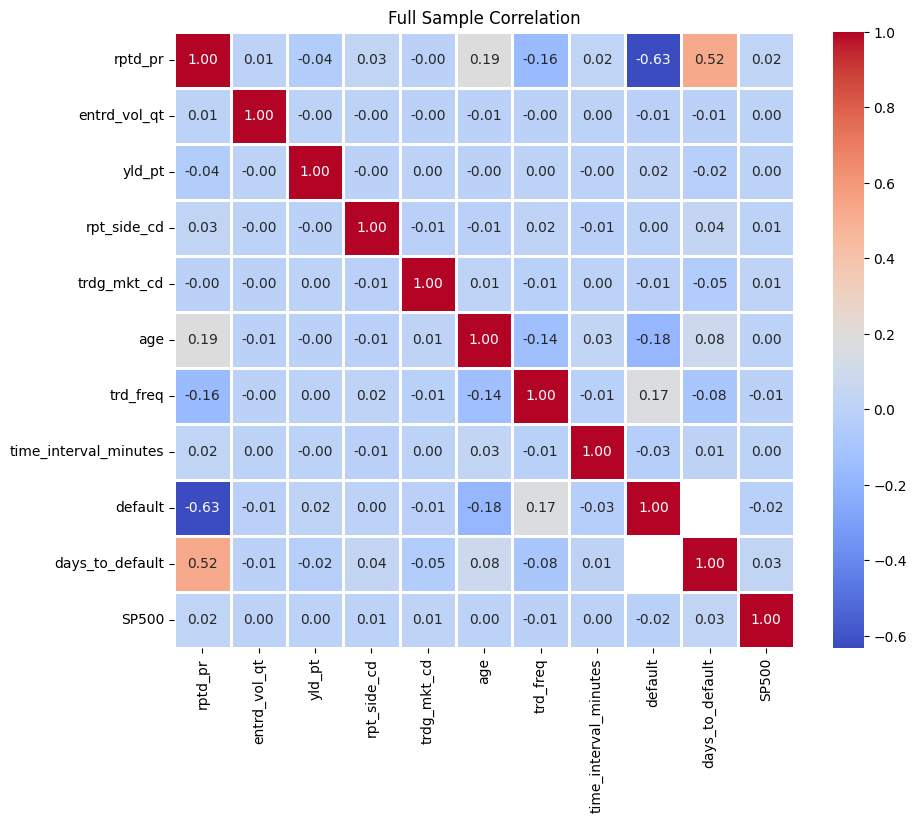

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


feature_columns = ['rptd_pr', 'entrd_vol_qt', 'yld_pt', 'rpt_side_cd', 'trdg_mkt_cd',
                   'age', 'trd_freq', 'time_interval_minutes', 'default', 'days_to_default', 'SP500']
df_features = XGB_df[feature_columns]

correlation_matrix = df_features.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=2)
plt.title('Full Sample Correlation')
plt.show()

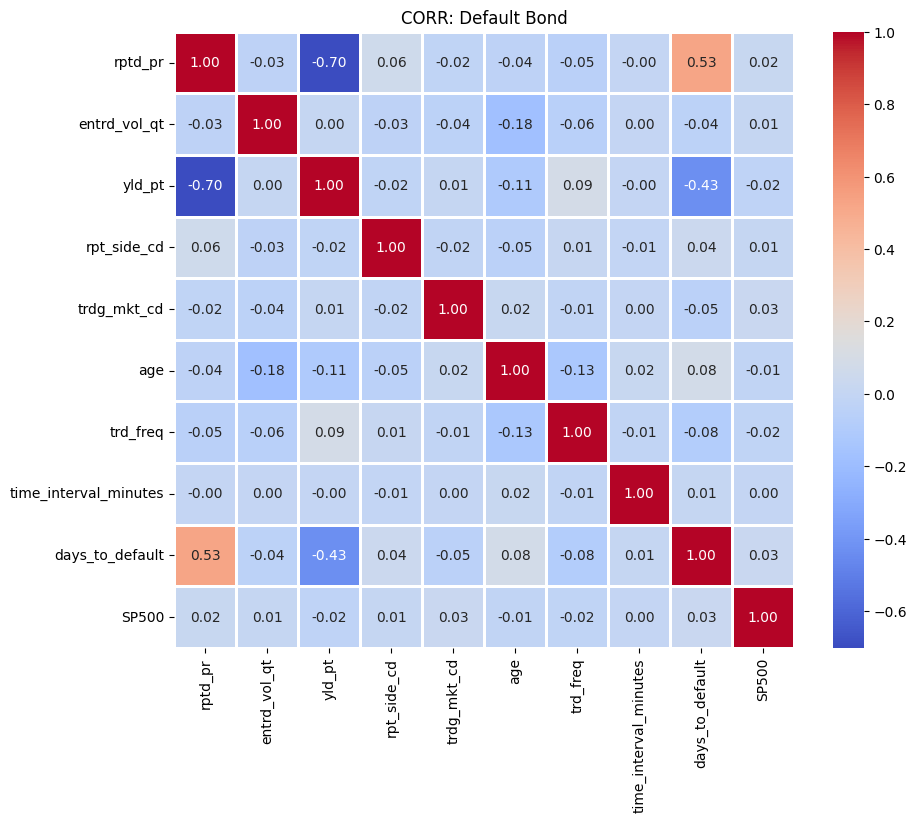

In [ ]:
feature_columns = ['rptd_pr', 'entrd_vol_qt', 'yld_pt', 'rpt_side_cd', 'trdg_mkt_cd',
                   'age', 'trd_freq', 'time_interval_minutes', 'days_to_default', 'SP500']
DF_features = DF_df[feature_columns]

correlation_matrix = DF_features.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=2)
plt.title('CORR: Default Bond')
plt.show()

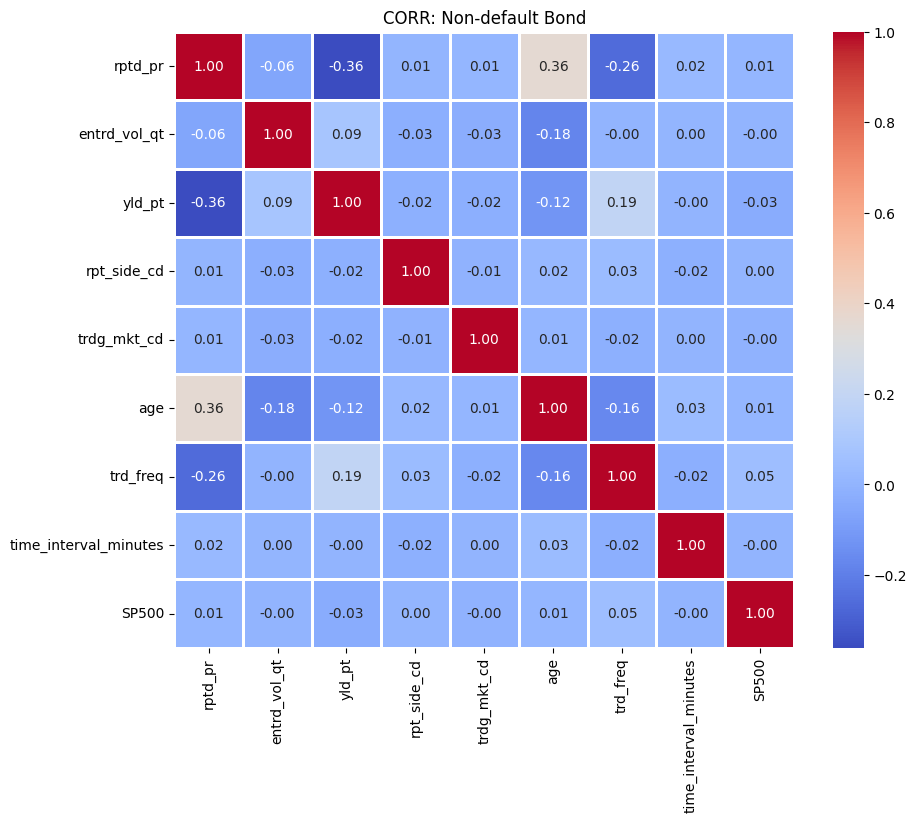

In [ ]:
feature_columns = ['rptd_pr', 'entrd_vol_qt', 'yld_pt', 'rpt_side_cd', 'trdg_mkt_cd',
                   'age', 'trd_freq', 'time_interval_minutes', 'SP500']
ND_features = ND_df[feature_columns]

correlation_matrix = ND_features.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=2)
plt.title('CORR: Non-default Bond')
plt.show()

## 3. Time Series Plots

<ipython-input-80-4e3635429696>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_nd_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_nd_df['trd_exctn_dt'])
<ipython-input-80-4e3635429696>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df_df['trd_exctn_dt'])


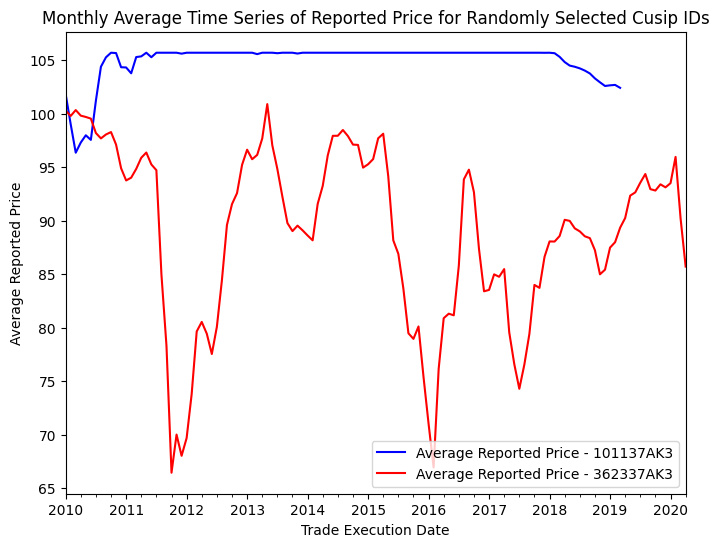

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import random

random_cusip_nd = random.choice(ND_df['cusip_id'].unique())
random_cusip_df = random.choice(DF_df['cusip_id'].unique())

plt.figure(figsize=(8, 6))

specific_bond_nd_df = ND_df[ND_df['cusip_id'] == random_cusip_nd]
specific_bond_nd_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_nd_df['trd_exctn_dt'])
specific_bond_nd_df.set_index('trd_exctn_dt', inplace=True)
monthly_avg_prices_nd = specific_bond_nd_df['rptd_pr'].resample('M').mean()
monthly_avg_prices_nd.plot(label=f'Average Reported Price - {random_cusip_nd}', color='blue')

specific_bond_df_df = DF_df[DF_df['cusip_id'] == random_cusip_df]
specific_bond_df_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df_df['trd_exctn_dt'])
specific_bond_df_df.set_index('trd_exctn_dt', inplace=True)
monthly_avg_prices_df = specific_bond_df_df['rptd_pr'].resample('M').mean()
monthly_avg_prices_df.plot(label=f'Average Reported Price - {random_cusip_df}', color='red')

plt.xlabel('Trade Execution Date')
plt.ylabel('Average Reported Price')
plt.title('Monthly Average Time Series of Reported Price for Randomly Selected Cusip IDs')
plt.legend()
plt.show()


<ipython-input-47-61be2d24bae9>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
<ipython-input-47-61be2d24bae9>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])


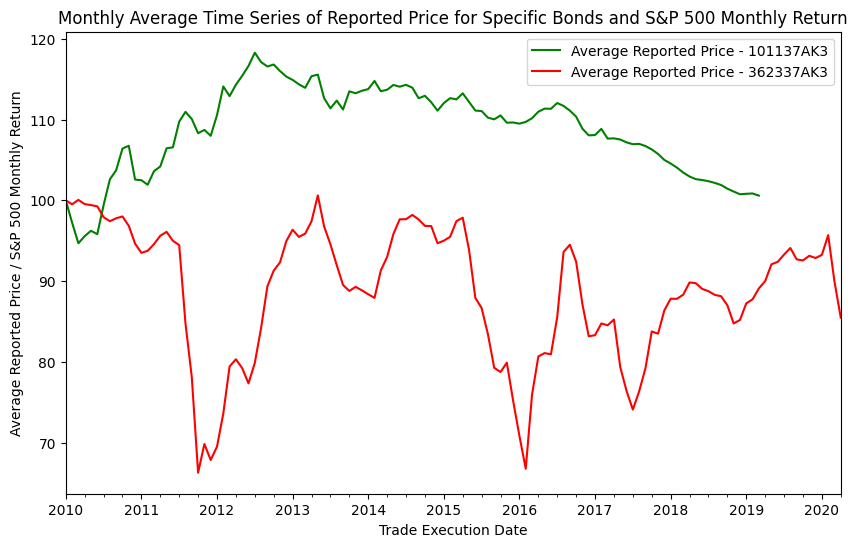

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

specific_cusip_ids = ['101137AK3', '362337AK3']
color_map = {'101137AK3': 'green', '362337AK3': 'red'}

plt.figure(figsize=(10, 6))

for specific_cusip_id in specific_cusip_ids:
    specific_bond_df = XGB_df[XGB_df['cusip_id'] == specific_cusip_id]
    specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
    specific_bond_df.set_index('trd_exctn_dt', inplace=True)

    # Calculate the percentage change in average prices
    monthly_avg_prices = specific_bond_df['rptd_pr'].resample('M').mean()
    percentage_change = (monthly_avg_prices / monthly_avg_prices.iloc[0]) * 100

    # Plot the percentage change for each cusip_id with corresponding color
    percentage_change.plot(label=f'Average Reported Price - {specific_cusip_id}', color=color_map[specific_cusip_id])

plt.xlabel('Trade Execution Date')
plt.ylabel('Average Reported Price / S&P 500 Monthly Return')
plt.title('Monthly Average Time Series of Reported Price for Specific Bonds and S&P 500 Monthly Return')
plt.legend()
plt.show()


<ipython-input-48-2ecb1c957c8d>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
<ipython-input-48-2ecb1c957c8d>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])


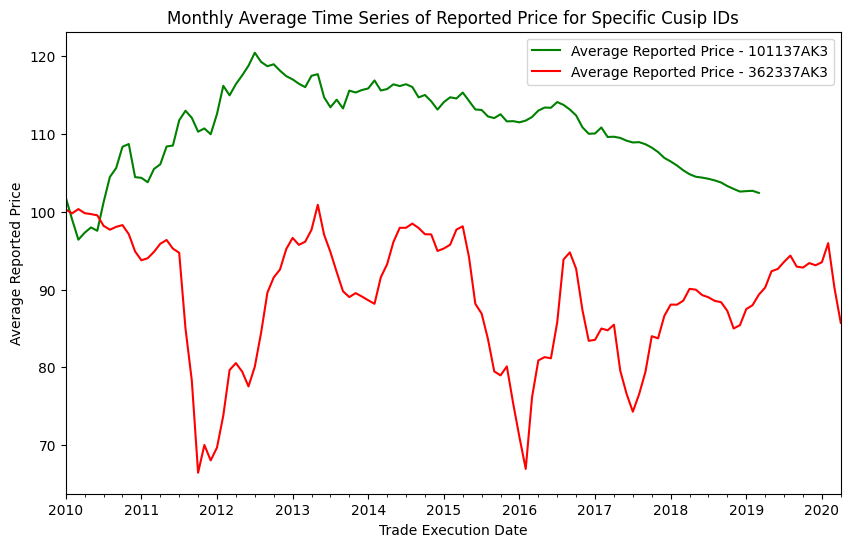

<ipython-input-48-2ecb1c957c8d>:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
<ipython-input-48-2ecb1c957c8d>:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])


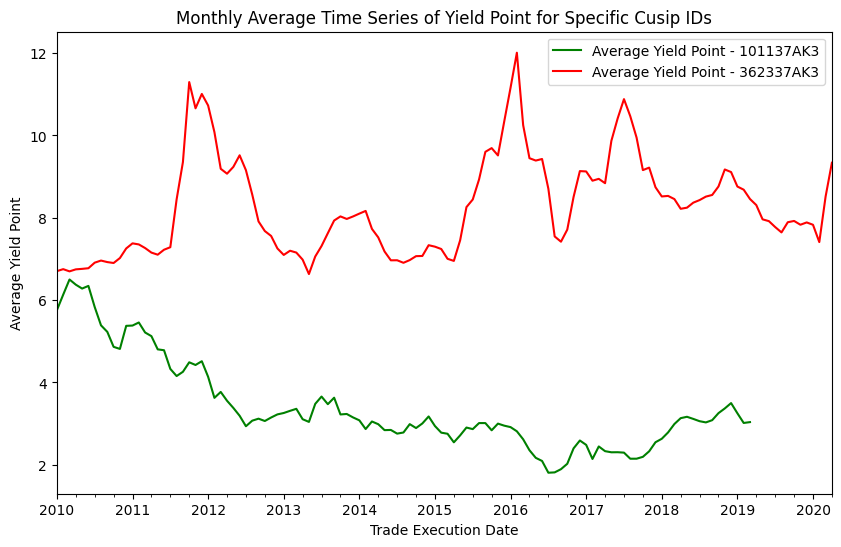

<ipython-input-48-2ecb1c957c8d>:50: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
<ipython-input-48-2ecb1c957c8d>:50: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])


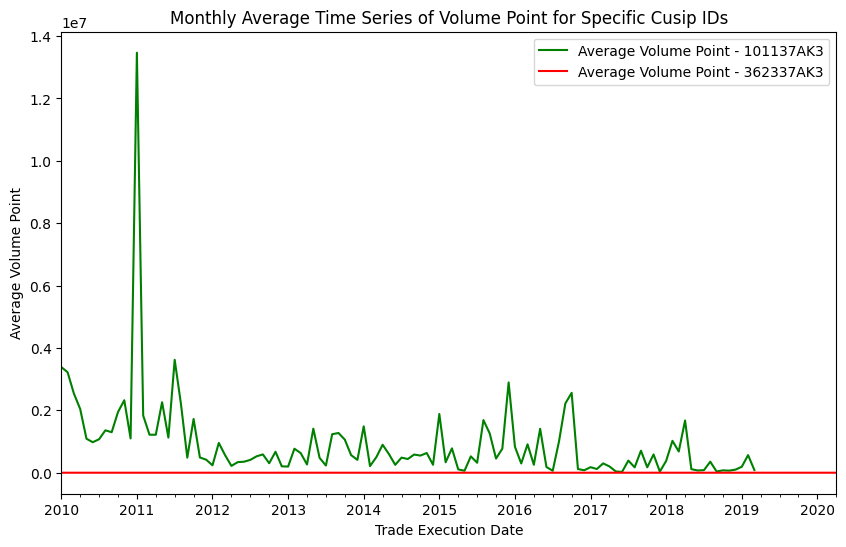

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

specific_cusip_ids = ['101137AK3', '362337AK3']

color_map = {'101137AK3': 'green', '362337AK3': 'red'}

plt.figure(figsize=(10, 6))

for specific_cusip_id in specific_cusip_ids:
    specific_bond_df = XGB_df[XGB_df['cusip_id'] == specific_cusip_id]
    specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
    specific_bond_df.set_index('trd_exctn_dt', inplace=True)

    # Average prices
    monthly_avg_prices = specific_bond_df['rptd_pr'].resample('M').mean()

    # Plot the average prices for each cusip_id with corresponding color
    monthly_avg_prices.plot(label=f'Average Reported Price - {specific_cusip_id}', color=color_map[specific_cusip_id])

plt.xlabel('Trade Execution Date')
plt.ylabel('Average Reported Price')
plt.title('Monthly Average Time Series of Reported Price for Specific Cusip IDs')
plt.legend()
plt.show()

plt.figure(figsize=(10, 6))

for specific_cusip_id in specific_cusip_ids:
    specific_bond_df = XGB_df[XGB_df['cusip_id'] == specific_cusip_id]
    specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
    specific_bond_df.set_index('trd_exctn_dt', inplace=True)

    # Average yields
    monthly_avg_yields = specific_bond_df['yld_pt'].resample('M').mean()

    # Plot the average yields for each cusip_id with corresponding color
    monthly_avg_yields.plot(label=f'Average Yield Point - {specific_cusip_id}', color=color_map[specific_cusip_id])

plt.xlabel('Trade Execution Date')
plt.ylabel('Average Yield Point')
plt.title('Monthly Average Time Series of Yield Point for Specific Cusip IDs')
plt.legend()
plt.show()

plt.figure(figsize=(10, 6))

for specific_cusip_id in specific_cusip_ids:
    specific_bond_df = XGB_df[XGB_df['cusip_id'] == specific_cusip_id]
    specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
    specific_bond_df.set_index('trd_exctn_dt', inplace=True)

    # Average volume
    monthly_avg_volume = specific_bond_df['entrd_vol_qt'].resample('M').mean()

    # Plot the average volume for each cusip_id with corresponding color
    monthly_avg_volume.plot(label=f'Average Volume Point - {specific_cusip_id}', color=color_map[specific_cusip_id])

plt.xlabel('Trade Execution Date')
plt.ylabel('Average Volume Point')
plt.title('Monthly Average Time Series of Volume Point for Specific Cusip IDs')
plt.legend()
plt.show()


<ipython-input-49-3c1fbb7f4dcb>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
<ipython-input-49-3c1fbb7f4dcb>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
<ipython-input-49-3c1fbb7f4dcb>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value inst

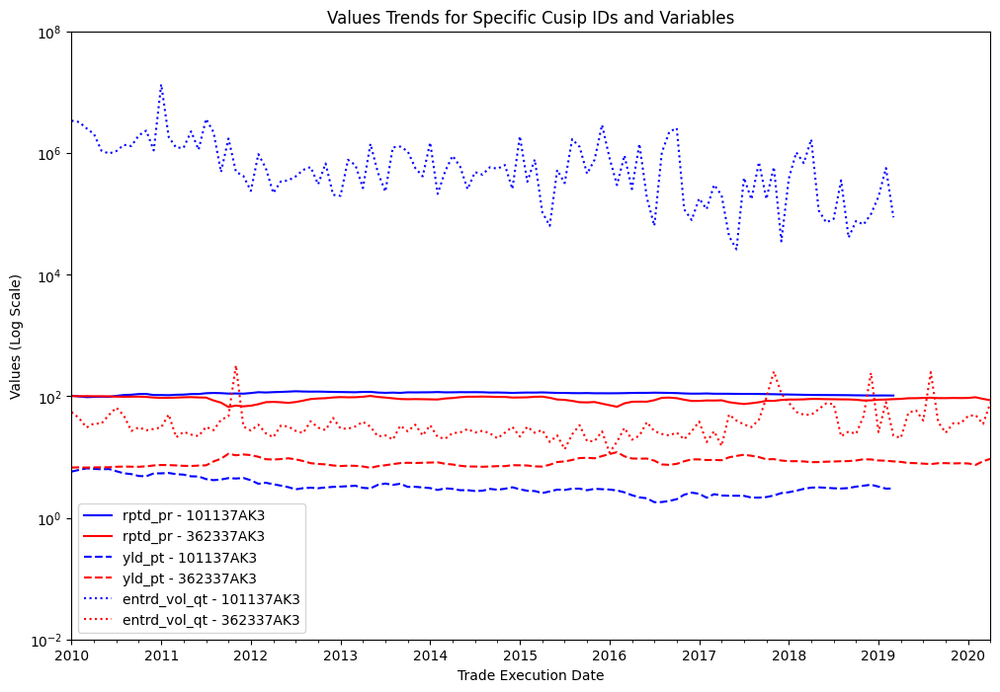

In [ ]:
value_set = ['101137AK3', '362337AK3']
variables = ['rptd_pr', 'yld_pt', 'entrd_vol_qt']

colors = {'101137AK3': 'blue', '362337AK3': 'red'}
linestyles = {'rptd_pr': '-', 'yld_pt': '--', 'entrd_vol_qt': ':'}

plt.figure(figsize=(12, 8))

for variable in variables:
    for specific_cusip_id in value_set:
        specific_bond_df = XGB_df[XGB_df['cusip_id'] == specific_cusip_id]
        specific_bond_df['trd_exctn_dt'] = pd.to_datetime(specific_bond_df['trd_exctn_dt'])
        specific_bond_df.set_index('trd_exctn_dt', inplace=True)

        data = specific_bond_df[variable].resample('M').mean()

        color = colors[specific_cusip_id]
        linestyle = linestyles[variable]

        plt.yscale('log')
        plt.ylim([0.01, 100000000])

        data.plot(label=f'{variable} - {specific_cusip_id}', color=color, linestyle=linestyle)

plt.xlabel('Trade Execution Date')
plt.ylabel('Values (Log Scale)')
plt.title('Values Trends for Specific Cusip IDs and Variables')
plt.legend()
plt.show()


## 4. PCA

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

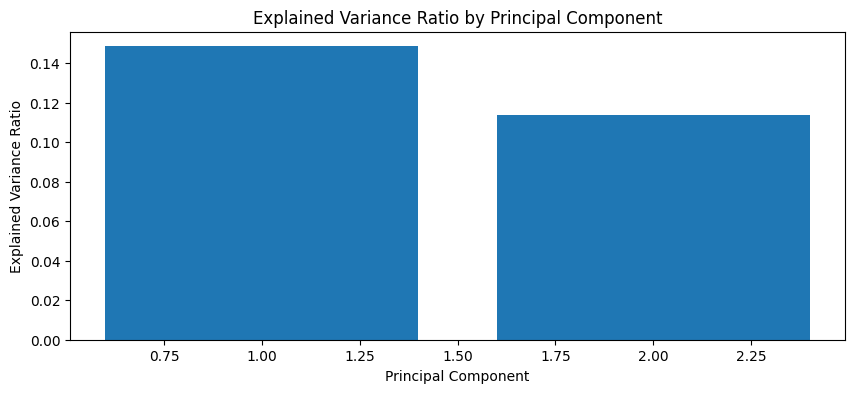

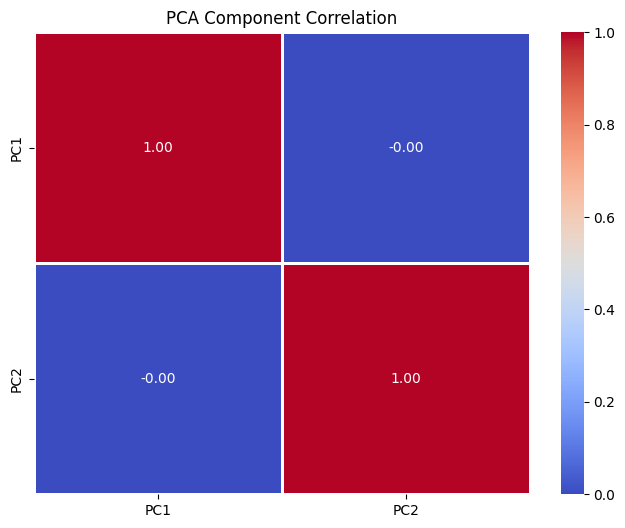

In [ ]:
# Select the feature columns
feature_columns = ['rptd_pr', 'entrd_vol_qt', 'yld_pt', 'rpt_side_cd', 'trdg_mkt_cd',
                   'age', 'trd_freq', 'time_interval_minutes', 'SP500']
df_features = XGB_df[feature_columns]

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df_features)

# Perform PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(scaled_data)

# Plot explained variance ratio
plt.figure(figsize=(10, 4))
plt.bar(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_)
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio by Principal Component')
plt.show()

# Plot PCA components
pca_df = pd.DataFrame(data=pca_result, columns=[f'PC{i}' for i in range(1, 3)])

# Calculate the correlation matrix of the PCA components
pca_correlation = pca_df.corr()

# Plot the heatmap of PCA component correlations
plt.figure(figsize=(8, 6))
sns.heatmap(pca_correlation, annot=True, cmap='coolwarm', fmt='.2f', linewidths=2)
plt.title('PCA Component Correlation')
plt.show()


# Results and analysis

### Split the sample in bond level

In [ ]:
from sklearn.model_selection import train_test_split
import pandas as pd

Rolling Windows

In [ ]:
XGB_df.sort_values(by=['cusip_id', 'trd_exctn_dt'], inplace=True)

def process_rolling_window(group):
    rolling_windows = group.rolling('30D', on='trd_exctn_dt', min_periods=1)
    rolling_stats = pd.DataFrame(index=group.index)

    feature_columns = group.columns.drop(['cusip_id', 'trd_exctn_dt'])
    for column in ['rptd_pr', 'entrd_vol_qt', 'yld_pt']:
        rolling_stats[f'mean_{column}'] = rolling_windows[column].mean()
        rolling_stats[f'std_{column}'] = rolling_windows[column].std()
        rolling_stats[f'median_{column}'] = rolling_windows[column].median()
        rolling_stats[f'max_{column}'] = rolling_windows[column].max()
        rolling_stats[f'min_{column}'] = rolling_windows[column].min()

    combined = pd.concat([group.reset_index(drop=True), rolling_stats.reset_index(drop=True)], axis=1)
    return combined

extended_df = pd.concat([process_rolling_window(group) for _, group in XGB_df.groupby('cusip_id')])


In [ ]:
extended_df['std_rptd_pr'].fillna(0, inplace=True)
extended_df['std_entrd_vol_qt'].fillna(0, inplace=True)
extended_df['std_yld_pt'].fillna(0, inplace=True)

print(extended_df.isnull().sum())


cusip_id                      0
trd_exctn_dt                  0
rptd_pr                       0
entrd_vol_qt                  0
yld_pt                        0
rpt_side_cd                   0
trdg_mkt_cd                   0
days_to_default          930560
OFFERING_DATE                 0
age                           0
trd_freq                      0
time_interval_minutes         0
default                       0
SP500                         0
year                          0
mean_rptd_pr                  0
std_rptd_pr                   0
median_rptd_pr                0
max_rptd_pr                   0
min_rptd_pr                   0
mean_entrd_vol_qt             0
std_entrd_vol_qt              0
median_entrd_vol_qt           0
max_entrd_vol_qt              0
min_entrd_vol_qt              0
mean_yld_pt                   0
std_yld_pt                    0
median_yld_pt                 0
max_yld_pt                    0
min_yld_pt                    0
dtype: int64


In [ ]:
ND_df = extended_df[extended_df['default'] == 0]
DF_df = extended_df[extended_df['default'] == 1]

In [ ]:
unique_nd_cusip = ND_df['cusip_id'].unique()
unique_df_cusip = DF_df['cusip_id'].unique()

count_unique_nd_cusip = len(unique_nd_cusip)
count_unique_df_cusip = len(unique_df_cusip)

print("Non-default bond:", count_unique_nd_cusip)
print("Default bond:", count_unique_df_cusip)

Non-default bond: 151
Default bond: 45


**Important**

Train<=2018<Test

In [ ]:
from sklearn.model_selection import train_test_split

pre_2018_ND_cusips = ND_df[ND_df['year'] < 2018]['cusip_id'].unique()
post_2018_ND_cusips = ND_df[ND_df['year'] >= 2018]['cusip_id'].unique()

pre_2018_DF_cusips = DF_df[DF_df['year'] < 2018]['cusip_id'].unique()
post_2018_DF_cusips = DF_df[DF_df['year'] >= 2018]['cusip_id'].unique()

train_cusips_ND, _ = train_test_split(pre_2018_ND_cusips, test_size=0.3, random_state=0)
train_cusips_DF, _ = train_test_split(pre_2018_DF_cusips, test_size=0.3, random_state=0)

min_post_2018_cusips = min(len(post_2018_ND_cusips), len(post_2018_DF_cusips))

test_cusips_ND = np.random.choice(post_2018_ND_cusips, min_post_2018_cusips, replace=False)
test_cusips_DF = np.random.choice(post_2018_DF_cusips, min_post_2018_cusips, replace=False)

train_data = extended_df[(extended_df['cusip_id'].isin(train_cusips_ND)) | (extended_df['cusip_id'].isin(train_cusips_DF))]
test_data = extended_df[(extended_df['cusip_id'].isin(test_cusips_ND)) | (extended_df['cusip_id'].isin(test_cusips_DF))]

print("New Train Data Shape:", train_data.shape)
print("New Test Data Shape:", test_data.shape)


New Train Data Shape: (1429131, 30)
New Test Data Shape: (866106, 30)


In [ ]:
# Count the number of unique cusip_ids from ND and DF in the train and test sets
num_nd_cusip_train = train_data[train_data['default'] == 0]['cusip_id'].nunique()
num_df_cusip_train = train_data[train_data['default'] == 1]['cusip_id'].nunique()

num_nd_cusip_test = test_data[test_data['default'] == 0]['cusip_id'].nunique()
num_df_cusip_test = test_data[test_data['default'] == 1]['cusip_id'].nunique()

print("Number of unique ND cusip_id in training set:", num_nd_cusip_train)
print("Number of unique DF cusip_id in training set:", num_df_cusip_train)
print("Number of unique ND cusip_id in testing set:", num_nd_cusip_test)
print("Number of unique DF cusip_id in testing set:", num_df_cusip_test)


Number of unique ND cusip_id in training set: 103
Number of unique DF cusip_id in training set: 30
Number of unique ND cusip_id in testing set: 28
Number of unique DF cusip_id in testing set: 28


In [ ]:
cusip_set_train = set(train_data['cusip_id'])
cusip_set_test = set(test_data['cusip_id'])

common_bond = cusip_set_train.intersection(cusip_set_test)

if len(common_bond) > 0:
    print("There are common CUSIPs between train and test datasets:")
    for cusip in common_bond:
        print(cusip)
else:
    print("No common CUSIPs between train and test datasets.")


No common CUSIPs between train and test datasets.


In [ ]:
print(train_data[['days_to_default', 'default']].describe())
print(test_data[['days_to_default', 'default']].describe())

       days_to_default    default
count        750579.00 1429131.00
mean           1256.54       0.53
std             887.80       0.50
min               1.00       0.00
25%             490.00       0.00
50%            1169.00       1.00
75%            1823.00       1.00
max            3870.00       1.00
       days_to_default   default
count        733864.00 850591.00
mean           1375.60      0.86
std             906.89      0.34
min               1.00      0.00
25%             612.00      1.00
50%            1272.00      1.00
75%            2006.00      1.00
max            3870.00      1.00


In [ ]:
train_columns = train_data.columns.tolist()
test_columns = test_data.columns.tolist()

print("Columns in Train Data:")
print(train_columns)

print("\nColumns in Test Data:")
print(test_columns)


Columns in Train Data:
['cusip_id', 'trd_exctn_dt', 'rptd_pr', 'entrd_vol_qt', 'yld_pt', 'rpt_side_cd', 'trdg_mkt_cd', 'days_to_default', 'OFFERING_DATE', 'age', 'trd_freq', 'time_interval_minutes', 'default', 'SP500', 'year', 'mean_rptd_pr', 'std_rptd_pr', 'median_rptd_pr', 'max_rptd_pr', 'min_rptd_pr', 'mean_entrd_vol_qt', 'std_entrd_vol_qt', 'median_entrd_vol_qt', 'max_entrd_vol_qt', 'min_entrd_vol_qt', 'mean_yld_pt', 'std_yld_pt', 'median_yld_pt', 'max_yld_pt', 'min_yld_pt']

Columns in Test Data:
['cusip_id', 'trd_exctn_dt', 'rptd_pr', 'entrd_vol_qt', 'yld_pt', 'rpt_side_cd', 'trdg_mkt_cd', 'days_to_default', 'OFFERING_DATE', 'age', 'trd_freq', 'time_interval_minutes', 'default', 'SP500', 'year', 'mean_rptd_pr', 'std_rptd_pr', 'median_rptd_pr', 'max_rptd_pr', 'min_rptd_pr', 'mean_entrd_vol_qt', 'std_entrd_vol_qt', 'median_entrd_vol_qt', 'max_entrd_vol_qt', 'min_entrd_vol_qt', 'mean_yld_pt', 'std_yld_pt', 'median_yld_pt', 'max_yld_pt', 'min_yld_pt']


## Step 1 Classification

In [ ]:
import xgboost as xgb
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report


### M2

In [ ]:
feature_columns = ['rptd_pr', 'entrd_vol_qt', 'yld_pt', 'age', 'SP500']

In [ ]:
feature_columns = ['rptd_pr', 'entrd_vol_qt', 'yld_pt', 'age', 'SP500',
                   'mean_rptd_pr', 'std_rptd_pr', 'median_rptd_pr', 'max_rptd_pr', 'min_rptd_pr',
                   'mean_entrd_vol_qt', 'std_entrd_vol_qt', 'median_entrd_vol_qt', 'max_entrd_vol_qt', 'min_entrd_vol_qt',
                   'mean_yld_pt', 'std_yld_pt', 'median_yld_pt', 'max_yld_pt', 'min_yld_pt']

In [ ]:
# Sample weight
weight_for_ND = 1
weight_for_DF = 1

sample_weights = train_data['default'].apply(lambda x: weight_for_DF if x == 1 else weight_for_ND)

# logistic model
logistic_model = LogisticRegression()
logistic_model.fit(train_data[feature_columns], train_data['default'])

# testing for each cusip_id in test set
confusion_matrices = {}
for cusip_id in test_data['cusip_id'].unique():
    test_subset = test_data[test_data['cusip_id'] == cusip_id]
    if test_subset.empty:
        continue

    predictions = logistic_model.predict(test_subset[feature_columns])
    cm_Logistic = confusion_matrix(test_subset['default'], predictions, labels=[0, 1])
    confusion_matrices[cusip_id] = cm_Logistic

for cusip_id, cm_Logistic in confusion_matrices.items():
    print(f'Confusion Matrix for cusip_id {cusip_id}:')
    print(cm_Logistic)
    print()


Confusion Matrix for cusip_id 00130HBN4:
[[9672  485]
 [   0    0]]

Confusion Matrix for cusip_id 007634AA6:
[[5729   39]
 [   0    0]]

Confusion Matrix for cusip_id 009158AJ5:
[[208   0]
 [  0   0]]

Confusion Matrix for cusip_id 018772AS2:
[[    0     0]
 [   19 92754]]

Confusion Matrix for cusip_id 02265QAA6:
[[421   0]
 [  0   0]]

Confusion Matrix for cusip_id 048825AW3:
[[2046   15]
 [   0    0]]

Confusion Matrix for cusip_id 05348EAN9:
[[1610   23]
 [   0    0]]

Confusion Matrix for cusip_id 073730AA1:
[[2957   15]
 [   0    0]]

Confusion Matrix for cusip_id 097023AD7:
[[12385    27]
 [    0     0]]

Confusion Matrix for cusip_id 09776NAF9:
[[    0     0]
 [    9 13948]]

Confusion Matrix for cusip_id 121899CF3:
[[463  18]
 [  0   0]]

Confusion Matrix for cusip_id 121899CG1:
[[384  16]
 [  0   0]]

Confusion Matrix for cusip_id 136440AL8:
[[2313    5]
 [   0    0]]

Confusion Matrix for cusip_id 144141BP2:
[[1086    1]
 [   0    0]]

Confusion Matrix for cusip_id 165167CK

In [ ]:
all_predictions_in_sample = logistic_model.predict(train_data[feature_columns])
all_actuals_in_sample = train_data['default']

accuracy_in_sample = accuracy_score(all_actuals_in_sample, all_predictions_in_sample)
precision_in_sample = precision_score(all_actuals_in_sample, all_predictions_in_sample, zero_division=0)
recall_in_sample = recall_score(all_actuals_in_sample, all_predictions_in_sample, zero_division=0)
f1_in_sample = f1_score(all_actuals_in_sample, all_predictions_in_sample, zero_division=0)

print("Overall Logistic Model Performance on In-Sample Training Set:")
print(f"Accuracy: {accuracy_in_sample:.4f}")
print(f"Precision: {precision_in_sample:.4f}")
print(f"Recall: {recall_in_sample:.4f}")
print(f"F1 Score: {f1_in_sample:.4f}")

print("\nIn Sample Classification Report:")
print(classification_report(all_actuals_in_sample, all_predictions_in_sample))


Overall Logistic Model Performance on In-Sample Training Set:
Accuracy: 0.9865
Precision: 0.9810
Recall: 0.9936
F1 Score: 0.9873

In Sample Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.98      0.99    678552
           1       0.98      0.99      0.99    750579

    accuracy                           0.99   1429131
   macro avg       0.99      0.99      0.99   1429131
weighted avg       0.99      0.99      0.99   1429131



In [ ]:
all_predictions_logistic = logistic_model.predict(test_data[feature_columns])
all_actuals_logistic = test_data['default']

accuracy_logistic = accuracy_score(all_actuals_logistic, all_predictions_logistic)
precision_logistic = precision_score(all_actuals_logistic, all_predictions_logistic)
recall_logistic = recall_score(all_actuals_logistic, all_predictions_logistic)
f1_logistic = f1_score(all_actuals_logistic, all_predictions_logistic)

print("Overall Logistic Model Performance on Out of Sample Test:")
print(f"Accuracy: {accuracy_logistic:.4f}")
print(f"Precision: {precision_logistic:.4f}")
print(f"Recall: {recall_logistic:.4f}")
print(f"F1 Score: {f1_logistic:.4f}")

print("\nOut of Sample Classification Report:")
print(classification_report(all_actuals_logistic, all_predictions_logistic))


Overall Logistic Model Performance on Out of Sample Test:
Accuracy: 0.9907
Precision: 0.9957
Recall: 0.9933
F1 Score: 0.9945

Out of Sample Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.98      0.97    132242
           1       1.00      0.99      0.99    733864

    accuracy                           0.99    866106
   macro avg       0.98      0.98      0.98    866106
weighted avg       0.99      0.99      0.99    866106



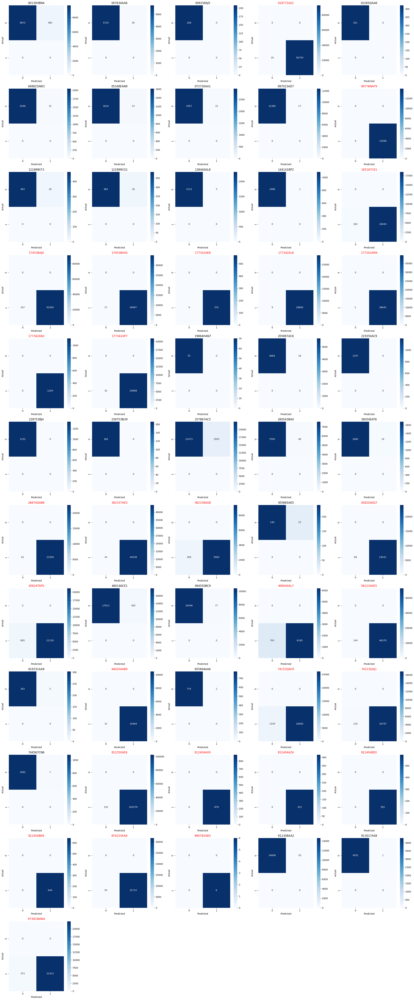

In [ ]:
labels = [0, 1]

confusion_matrices = {}
for cusip_id in test_data['cusip_id'].unique():
    test_subset = test_data[test_data['cusip_id'] == cusip_id]
    if test_subset.empty:
        continue

    predictions = logistic_model.predict(test_subset[feature_columns])
    logistic_cm_out_of_sample = confusion_matrix(test_subset['default'], predictions, labels=labels)
    confusion_matrices[cusip_id] = logistic_cm_out_of_sample

num_cusips = len(confusion_matrices)
cols = 5
rows = num_cusips // cols + (num_cusips % cols > 0)

plt.figure(figsize=(5 * cols, 5 * rows))

for i, (cusip_id, logistic_cm_out_of_sample) in enumerate(confusion_matrices.items(), 1):
    plt.subplot(rows, cols, i)
    sns.heatmap(logistic_cm_out_of_sample, annot=True, fmt='d', cmap='Blues')

    if test_data[test_data['cusip_id'] == cusip_id]['default'].any():
        title_color = 'red'
    else:
        title_color = 'black'

    plt.title(f'{cusip_id}', color=title_color)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')

plt.tight_layout()
plt.show()



In [ ]:
weight_for_ND = 1
weight_for_DF = 1

sample_weights = train_data['default'].apply(lambda x: weight_for_DF if x == 1 else weight_for_ND)

tree_model = DecisionTreeClassifier()
tree_model.fit(train_data[feature_columns], train_data['default'], sample_weight=sample_weights)

# testing for each cusip_id in test set
confusion_matrices = {}
for cusip_id in test_data['cusip_id'].unique():
    print(f'Predicting and evaluating for cusip_id: {cusip_id}')
    test_subset = test_data[test_data['cusip_id'] == cusip_id]
    if test_subset.empty:
        continue

    predictions = tree_model.predict(test_subset[feature_columns])
    cm_tree = confusion_matrix(test_subset['default'], predictions, labels=[0, 1])
    confusion_matrices[cusip_id] = cm_tree

for cusip_id, cm_tree in confusion_matrices.items():
    print(f'Confusion Matrix for cusip_id {cusip_id}:')
    print(cm_tree)
    print()


Predicting and evaluating for cusip_id: 00130HBN4
Predicting and evaluating for cusip_id: 007634AA6
Predicting and evaluating for cusip_id: 009158AJ5
Predicting and evaluating for cusip_id: 018772AS2
Predicting and evaluating for cusip_id: 02265QAA6
Predicting and evaluating for cusip_id: 048825AW3
Predicting and evaluating for cusip_id: 05348EAN9
Predicting and evaluating for cusip_id: 073730AA1
Predicting and evaluating for cusip_id: 097023AD7
Predicting and evaluating for cusip_id: 09776NAF9
Predicting and evaluating for cusip_id: 121899CF3
Predicting and evaluating for cusip_id: 121899CG1
Predicting and evaluating for cusip_id: 136440AL8
Predicting and evaluating for cusip_id: 144141BP2
Predicting and evaluating for cusip_id: 165167CK1
Predicting and evaluating for cusip_id: 17453BAJ0
Predicting and evaluating for cusip_id: 17453BAS0
Predicting and evaluating for cusip_id: 177342AK8
Predicting and evaluating for cusip_id: 177342AL6
Predicting and evaluating for cusip_id: 177342AM4


In [ ]:
in_sample_predictions = tree_model.predict(train_data[feature_columns])
in_sample_actuals = train_data['default']

accuracy_in_sample = accuracy_score(in_sample_actuals, in_sample_predictions)
precision_in_sample = precision_score(in_sample_actuals, in_sample_predictions, zero_division=0)
recall_in_sample = recall_score(in_sample_actuals, in_sample_predictions, zero_division=0)
f1_in_sample = f1_score(in_sample_actuals, in_sample_predictions, zero_division=0)

print("Decision Tree Model Performance on In-Sample Training Set:")
print(f"Accuracy: {accuracy_in_sample:.4f}")
print(f"Precision: {precision_in_sample:.4f}")
print(f"Recall: {recall_in_sample:.4f}")
print(f"F1 Score: {f1_in_sample:.4f}")

Decision Tree Model Performance on In-Sample Training Set:
Accuracy: 1.0000
Precision: 1.0000
Recall: 1.0000
F1 Score: 1.0000


In [ ]:
out_of_sample_predictions = tree_model.predict(test_data[feature_columns])
out_of_sample_actuals = test_data['default']

accuracy_out_of_sample = accuracy_score(out_of_sample_actuals, out_of_sample_predictions)
precision_out_of_sample = precision_score(out_of_sample_actuals, out_of_sample_predictions, zero_division=0)
recall_out_of_sample = recall_score(out_of_sample_actuals, out_of_sample_predictions, zero_division=0)
f1_out_of_sample = f1_score(out_of_sample_actuals, out_of_sample_predictions, zero_division=0)

print("Decision Tree Model Performance on Out-of-Sample Test Set:")
print(f"Accuracy: {accuracy_out_of_sample:.4f}")
print(f"Precision: {precision_out_of_sample:.4f}")
print(f"Recall: {recall_out_of_sample:.4f}")
print(f"F1 Score: {f1_out_of_sample:.4f}")

print("\nClassification Report for Out-of-Sample:")
print(classification_report(out_of_sample_actuals, out_of_sample_predictions))


Decision Tree Model Performance on Out-of-Sample Test Set:
Accuracy: 0.9986
Precision: 1.0000
Recall: 0.9984
F1 Score: 0.9992

Classification Report for Out-of-Sample:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00    132242
           1       1.00      1.00      1.00    733864

    accuracy                           1.00    866106
   macro avg       1.00      1.00      1.00    866106
weighted avg       1.00      1.00      1.00    866106



Predicting and evaluating for cusip_id: 00130HBN4
Predicting and evaluating for cusip_id: 007634AA6
Predicting and evaluating for cusip_id: 009158AJ5
Predicting and evaluating for cusip_id: 018772AS2
Predicting and evaluating for cusip_id: 02265QAA6
Predicting and evaluating for cusip_id: 048825AW3
Predicting and evaluating for cusip_id: 05348EAN9
Predicting and evaluating for cusip_id: 073730AA1
Predicting and evaluating for cusip_id: 097023AD7
Predicting and evaluating for cusip_id: 09776NAF9
Predicting and evaluating for cusip_id: 121899CF3
Predicting and evaluating for cusip_id: 121899CG1
Predicting and evaluating for cusip_id: 136440AL8
Predicting and evaluating for cusip_id: 144141BP2
Predicting and evaluating for cusip_id: 165167CK1
Predicting and evaluating for cusip_id: 17453BAJ0
Predicting and evaluating for cusip_id: 17453BAS0
Predicting and evaluating for cusip_id: 177342AK8
Predicting and evaluating for cusip_id: 177342AL6
Predicting and evaluating for cusip_id: 177342AM4


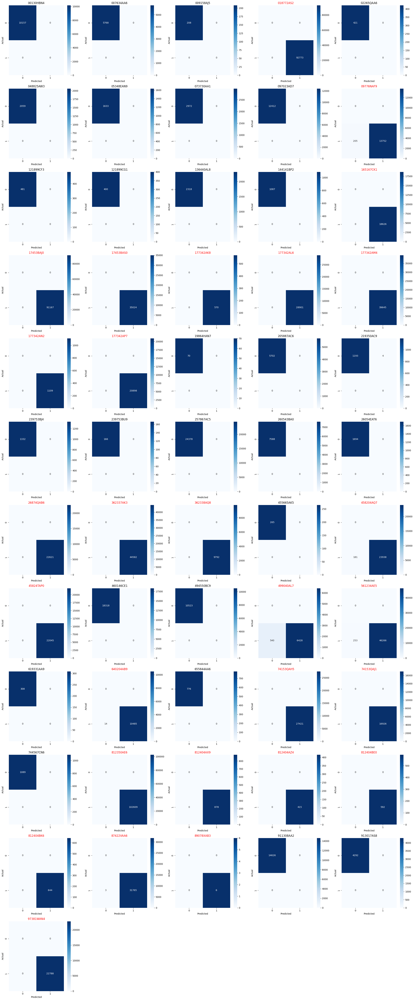

In [ ]:
labels = [0, 1]

confusion_matrices = {}
for cusip_id in test_data['cusip_id'].unique():
    print(f'Predicting and evaluating for cusip_id: {cusip_id}')
    test_subset = test_data[test_data['cusip_id'] == cusip_id]
    if test_subset.empty:
        continue

    predictions = tree_model.predict(test_subset[feature_columns])
    cm_tree = confusion_matrix(test_subset['default'], predictions, labels=labels)
    confusion_matrices[cusip_id] = cm_tree

num_cusips = len(confusion_matrices)
cols = 5
rows = num_cusips // cols + (num_cusips % cols > 0)

plt.figure(figsize=(5 * cols, 5 * rows))

for i, (cusip_id, cm_tree_out_of_sample) in enumerate(confusion_matrices.items(), 1):
    plt.subplot(rows, cols, i)
    sns.heatmap(cm_tree_out_of_sample, annot=True, fmt='d', cmap='Blues')

    if test_data[test_data['cusip_id'] == cusip_id]['default'].any():
        title_color = 'red'
    else:
        title_color = 'black'

    plt.title(f'{cusip_id}', color=title_color)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')

plt.tight_layout()
plt.show()


In [ ]:
xgb_model = xgb.XGBClassifier()
xgb_model.fit(train_data[feature_columns], train_data['default'])

in_sample_predictions = xgb_model.predict(train_data[feature_columns])
in_sample_actuals = train_data['default']

accuracy_in_sample = accuracy_score(in_sample_actuals, in_sample_predictions)
precision_in_sample = precision_score(in_sample_actuals, in_sample_predictions, zero_division=0)
recall_in_sample = recall_score(in_sample_actuals, in_sample_predictions, zero_division=0)
f1_in_sample = f1_score(in_sample_actuals, in_sample_predictions, zero_division=0)

print("XGBoost Model Performance on In-Sample Training Set:")
print(f"Accuracy: {accuracy_in_sample:.4f}")
print(f"Precision: {precision_in_sample:.4f}")
print(f"Recall: {recall_in_sample:.4f}")
print(f"F1 Score: {f1_in_sample:.4f}")

print("\nClassification Report for In-Sample:")
print(classification_report(in_sample_actuals, in_sample_predictions))


XGBoost Model Performance on In-Sample Training Set:
Accuracy: 0.9997
Precision: 0.9999
Recall: 0.9995
F1 Score: 0.9997

Classification Report for In-Sample:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    678552
           1       1.00      1.00      1.00    750579

    accuracy                           1.00   1429131
   macro avg       1.00      1.00      1.00   1429131
weighted avg       1.00      1.00      1.00   1429131



In [ ]:
out_of_sample_predictions = xgb_model.predict(test_data[feature_columns])
out_of_sample_actuals = test_data['default']

accuracy_out_of_sample = accuracy_score(out_of_sample_actuals, out_of_sample_predictions)
precision_out_of_sample = precision_score(out_of_sample_actuals, out_of_sample_predictions, zero_division=0)
recall_out_of_sample = recall_score(out_of_sample_actuals, out_of_sample_predictions, zero_division=0)
f1_out_of_sample = f1_score(out_of_sample_actuals, out_of_sample_predictions, zero_division=0)

print("XGBoost Model Performance on Out-of-Sample Test Set:")
print(f"Accuracy: {accuracy_out_of_sample:.4f}")
print(f"Precision: {precision_out_of_sample:.4f}")
print(f"Recall: {recall_out_of_sample:.4f}")
print(f"F1 Score: {f1_out_of_sample:.4f}")

print("\nClassification Report for Out-of-Sample:")
print(classification_report(out_of_sample_actuals, out_of_sample_predictions))


XGBoost Model Performance on Out-of-Sample Test Set:
Accuracy: 0.9991
Precision: 1.0000
Recall: 0.9989
F1 Score: 0.9994

Classification Report for Out-of-Sample:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00    132242
           1       1.00      1.00      1.00    733864

    accuracy                           1.00    866106
   macro avg       1.00      1.00      1.00    866106
weighted avg       1.00      1.00      1.00    866106



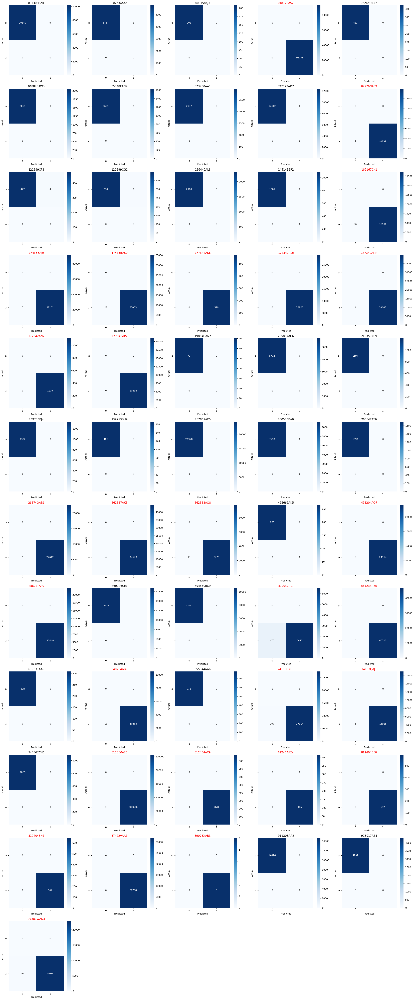

In [ ]:
labels = [0, 1]

confusion_matrices = {}
for cusip_id in test_data['cusip_id'].unique():
    test_subset = test_data[test_data['cusip_id'] == cusip_id]
    if test_subset.empty:
        continue

    predictions = xgb_model.predict(test_subset[feature_columns])
    cm_xgb = confusion_matrix(test_subset['default'], predictions, labels=labels)
    confusion_matrices[cusip_id] = cm_xgb

num_cusips = len(confusion_matrices)
cols = 5
rows = num_cusips // cols + (num_cusips % cols > 0)

plt.figure(figsize=(5 * cols, 5 * rows))

for i, (cusip_id, cm_xgb) in enumerate(confusion_matrices.items(), 1):
    plt.subplot(rows, cols, i)
    sns.heatmap(cm_xgb, annot=True, fmt='d', cmap='Blues')

    if test_data[test_data['cusip_id'] == cusip_id]['default'].any():
        title_color = 'red'
    else:
        title_color = 'black'

    plt.title(f'{cusip_id}', color=title_color)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')

plt.tight_layout()
plt.show()
